# OPTIONAL Workbook for Homework #8

You are welcome to work on a local version of a notebook and upload it for this assignment.

This workspace is here if you'd rather not have to install all necessary packages locally.

You can download any json files to your local computer to add them to your jekyll page.

To download, you can right-click on the file and hit download.  For example, with the following code:

```python
from vega_datasets import data
import altair as alt

source = data.cars()
source.rename(columns={"Miles_per_Gallon":"Miles per Gallon"}, 
              inplace=True)


chart = alt.Chart(source).mark_circle(size=60).encode(
    x='Horsepower',
    y='Miles per Gallon',
    color='Origin',
    tooltip=['Name', 'Origin', 'Horsepower', 'Miles per Gallon']
).interactive()

chart.properties(width='container').save("cars.json")
```

You can download from the side bar like this:

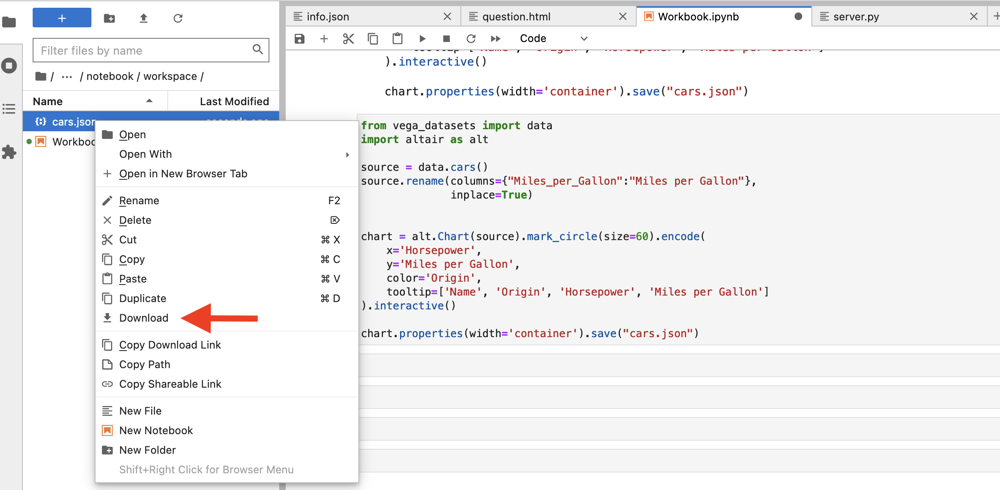

In [1]:
import pandas as pd
import altair as alt

In [2]:
df = pd.read_csv("https://raw.githubusercontent.com/UIUC-iSchool-DataViz/is445_data/main/building_inventory.csv")
df.head()

,Agency Name,Location Name,Address,City,Zip code,County,Congress Dist,Congressional Full Name,Rep Dist,Rep Full Name,...,Bldg Status,Year Acquired,Year Constructed,Square Footage,Total Floors,Floors Above Grade,Floors Below Grade,Usage Description,Usage Description 2,Usage Description 3
0,Department of Natural Resources,Anderson Lake Conservation Area - Fulton County,Anderson Lake C.a.,Astoria,61501,Fulton,17,Cheri Bustos,93,Hammond Norine K.,...,In Use,1975,1975,144,1,1,0,Unusual,Unusual,Not provided
1,Department of Natural Resources,Anderson Lake Conservation Area - Fulton County,Anderson Lake C.a.,Astoria,61501,Fulton,17,Cheri Bustos,93,Hammond Norine K.,...,In Use,2004,2004,144,1,1,0,Unusual,Unusual,Not provided
2,Department of Natural Resources,Anderson Lake Conservation Area - Fulton County,Anderson Lake C.a.,Astoria,61501,Fulton,17,Cheri Bustos,93,Hammond Norine K.,...,In Use,2004,2004,144,1,1,0,Unusual,Unusual,Not provided
3,Department of Natural Resources,Anderson Lake Conservation Area - Fulton County,Anderson Lake C.a.,Astoria,61501,Fulton,17,Cheri Bustos,93,Hammond Norine K.,...,In Use,2004,2004,144,1,1,0,Unusual,Unusual,Not provided
4,Department of Natural Resources,Anderson Lake Conservation Area - Fulton County,Anderson Lake C.a.,Astoria,61501,Fulton,17,Cheri Bustos,93,Hammond Norine K.,...,In Use,2004,2004,144,1,1,0,Unusual,Unusual,Not provided


In [3]:
df = df[df["Year Constructed"] > 0]

In [4]:
df.shape

(8573, 22)

In [5]:
# https://stackoverflow.com/questions/46658232/pandas-convert-column-with-year-integer-to-datetime
# converting Year Constructed column to datetime for visualization in chronologically
df["Year Constructed"] = pd.to_datetime(df['Year Constructed'], format='%Y')

In [6]:
# extend max data usage
alt.data_transformers.disable_max_rows()
print(alt.Chart(df).mark_point().to_json())

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [7]:
# check Altair library works
alt.Chart(df).mark_point()

alt.Chart(...)

In [8]:
# example chart 1
alt.Chart(df).mark_point().encode(
    x = "Total Floors:O",
    y = "Square Footage"
)

alt.Chart(...)

In [9]:
# example chart 2
alt.Chart(df).mark_point().encode(
    x = "Total Floors:O",
    y = "Square Footage",
    color = alt.value('red')
).interactive()

alt.Chart(...)

In [10]:
#sorted(list(df["Year Constructed"].unique()))

In [11]:
# https://altair-viz.github.io/user_guide/marks/line.html
# 1. Line chart that showing building constructed by year
strokeWidth_slider = alt.binding_range(min=0, max=10, step=0.5, name="strokeWidth")
strokeWidth_var = alt.param(bind=strokeWidth_slider, value=2)

#year_range = list(range(1753,2020))
year_range = sorted(list(df["Year Constructed"].unique()))
year_select_start = alt.binding_select(
    options=year_range,
    name="year 1"
)
year_select_start_var = alt.param(bind=year_select_start, value="1753-01-01T00:00:00")


year_select_end = alt.binding_select(
    options=year_range,
    name="year 2"
)
year_select_end_var = alt.param(bind=year_select_end, value="2019-01-01T00:00:00")

chart_line = alt.Chart(df).mark_line(
    strokeWidth=strokeWidth_var
).encode(
    #x = "Total Floors:O",
    x = "Year Constructed:O",
    # https://altair-viz.github.io/user_guide/transform/aggregate.html
    y = "count(Year Acquired)"
).transform_filter(
    # https://altair-viz.github.io/user_guide/transform/filter.html
   # {"not": alt.FieldEqualPredicate(field="Year Constructed", equal=0)},
    alt.FieldRangePredicate(field='Year Constructed', range=[year_select_start_var, year_select_end_var])
).add_params(
    strokeWidth_var, year_select_start_var, year_select_end_var
).interactive()

chart_line

alt.Chart(...)

In [12]:
chart_line.properties(width='container').save("line_chart.json")

In [13]:
# https://altair-viz.github.io/user_guide/marks/bar.html
# 2. bar chart that showing building constructed by year
year_range2 = sorted(list(df["Year Constructed"].unique()))
year_select_start2 = alt.binding_select(
    options=year_range2,
    name="year 1"
)
year_select_start_var2 = alt.param(bind=year_select_start2, value="1753-01-01T00:00:00")


year_select_end2 = alt.binding_select(
    options=year_range2,
    name="year 2"
)
year_select_end_var2 = alt.param(bind=year_select_end2, value="2019-01-01T00:00:00")

chart_bar = alt.Chart(df).mark_bar().encode(
    x = "Congress Dist:N",
    y = "count(Year Constructed)",
    color = "Bldg Status"
).transform_filter(
    alt.FieldRangePredicate(field='Year Constructed', range=[year_select_start_var2, year_select_end_var2])
).add_params(
    year_select_start_var2, year_select_end_var2
)

chart_bar

alt.Chart(...)

In [14]:
chart_bar.properties(width='container').save("bar_chart.json")